In [ ]:
import cdsapi
import climetlab as cml
import numpy as np
import matplotlib.pyplot as plt
import geopandas
import geopy
import xarray as xr
import pandas as pd

import csv
import os
import pickle

import scipy
import sklearn 
from sklearn.cluster import KMeans

import seaborn as sns

Read V2 Table

In [1]:
def read_table_v2(path):
    ft = pd.read_csv(path)
    for row in ft.iterrows():
        print(row[1]['State'])
    return ft

In [2]:
ft = read_table_v2("../tables/state_regularized_v2.csv")

NameError: name 'pd' is not defined

Testing purposes.
Check values

In [37]:
means = xr.open_dataset('../../a/state_means/global_mean.nc')
x = xr.open_dataset('../../a/era5_data/12-31-2022.nc')

currLocation = geopandas.tools.geocode("Arkansas")
lat = currLocation.geometry.y.values[0]
lon = currLocation.geometry.x.values[0] + 360.

# print(means)

state_mean = means.sel(latitude=slice(lat+2.5,lat-2.5), longitude=slice(lon-2.5,lon+2.5),time='2022-12-01')
# print(state_mean.sf)
locate =  x.sel(latitude=slice(lat+2.5,lat-2.5), longitude=slice(lon-2.5,lon+2.5), time='2022-12-31T12:00:00')

print(state_mean.tp.to_dataframe())
print(locate.tp.to_dataframe())


                         time        tp
latitude longitude                     
37.50    265.25    2022-12-01  0.001386
         265.50    2022-12-01  0.001536
         265.75    2022-12-01  0.001661
         266.00    2022-12-01  0.001661
         266.25    2022-12-01  0.001659
...                       ...       ...
32.75    269.00    2022-12-01  0.004173
         269.25    2022-12-01  0.004346
         269.50    2022-12-01  0.004368
         269.75    2022-12-01  0.004212
         270.00    2022-12-01  0.004014

[400 rows x 2 columns]
                                  time        tp
latitude longitude                              
37.50    265.25    2022-12-31 12:00:00  0.000000
         265.50    2022-12-31 12:00:00  0.000000
         265.75    2022-12-31 12:00:00  0.000000
         266.00    2022-12-31 12:00:00  0.000000
         266.25    2022-12-31 12:00:00  0.000000
...                                ...       ...
32.75    269.00    2022-12-31 12:00:00  0.000232
         269.25

Define states

In [4]:
states = ["Alaska", "Alabama", "Arkansas", "Arizona", "California", "Colorado", "Connecticut", "Delaware", "Florida", "Georgia", "Hawaii", "Iowa", "Idaho", "Illinois", "Indiana", "Kansas", "Kentucky", "Louisiana", "Massachusetts", "Maryland", "Maine", "Michigan", "Minnesota", "Missouri", "Mississippi", "Montana", "North Carolina", "North Dakota", "Nebraska", "New Hampshire", "New Jersey", "New Mexico", "Nevada", "New York", "Ohio", "Oklahoma", "Oregon", "Pennsylvania", "Rhode Island", "South Carolina", "South Dakota", "Tennessee", "Texas", "Utah", "Virginia", "Vermont", "Washington", "Wisconsin", "West Virginia", "Wyoming"]

Testing for wind data

In [19]:
def wind_test(ft):
    means = xr.open_dataset('../../a/state_means/global_mean.nc')
    x = xr.open_dataset('../../a/era5_data/12-31-2022.nc')

    currLocation = geopandas.tools.geocode("Oregon")
    lat = currLocation.geometry.y.values[0]
    lon = currLocation.geometry.x.values[0] + 360.

    # print(means)

    state_mean = means.sel(latitude=slice(lat+2.5,lat-2.5), longitude=slice(lon-2.5,lon+2.5),time='2022-12-01')
    # print(state_mean.sf)
    locate =  x.sel(latitude=slice(lat+2.5,lat-2.5), longitude=slice(lon-2.5,lon+2.5), time='2022-12-31T12:00:00')

    print(locate.to_dataframe())

    # print(get_wind(locate))

def get_wind(xr):
    total = xr.to_dataframe()
    total['mag'] = np.sqrt(np.square(total['u10'])+np.square(total['v10']))
    print(total)
    return total['mag']


   

In [20]:
wind_test(ft)

                                  time       u10       v10         t2m  \
longitude latitude                                                       
237.00    46.25    2022-12-31 12:00:00 -0.015557  2.112958  280.268494   
          46.00    2022-12-31 12:00:00 -0.053224  1.732808  280.283752   
          45.75    2022-12-31 12:00:00  0.272788  1.710582  279.709442   
          45.50    2022-12-31 12:00:00  0.647507  1.899890  279.625427   
          45.25    2022-12-31 12:00:00  0.807266  2.451721  280.210449   
...                                ...       ...       ...         ...   
241.75    42.50    2022-12-31 12:00:00  2.421090  0.977873  275.075043   
          42.25    2022-12-31 12:00:00  3.254303 -0.006225  275.739502   
          42.00    2022-12-31 12:00:00  1.817773 -1.540621  275.591339   
          41.75    2022-12-31 12:00:00  0.724139 -1.506898  276.026672   
          41.50    2022-12-31 12:00:00  0.463070 -0.721306  280.031738   

                              sf     

Accumulate data for all variables

In [34]:
def accumulate_state_data(ft):
    start = False
    state_dfs_raw = {}
    state_dfs_anom = {}
    for state in states:
        currLocation = geopandas.tools.geocode(state)
        sdf_raw = pd.DataFrame()
        sdf_anom = pd.DataFrame()
        for row in ft.iterrows():
            i = row[1]

            if "nan"in str(i['State']) or "DIRTY" in str(i['State']):
                continue
            if state not in str(i['State']):
                continue



            means = xr.open_dataset('../../a/state_means/global_mean.nc')

            date = str(i['Valid Date']).split('-')


            file_name = date[1] + '-' + date[2] + '-' + date[0] + '.nc'
            x = xr.open_dataset('../../a/era5_data/' + file_name)
            
            datetime = str(i['Valid Date']) + 'T12:00:00'




            lat = currLocation.geometry.y.values[0]
            lon = currLocation.geometry.x.values[0] + 360.

            state_mean = means.sel(latitude=slice(lat+2.5,lat-2.5), longitude=slice(lon-2.5,lon+2.5),time=date[0] + '-' + date[1] + '-01')
        
            locate =  x.sel(latitude=slice(lat+2.5,lat-2.5), longitude=slice(lon-2.5,lon+2.5), time=datetime)

            anom_t2m = locate.t2m.to_dataframe() - state_mean.t2m.to_dataframe()

            raw_t2m = locate.t2m.to_dataframe()

            raw_tp_col = locate.tp.to_dataframe()["tp"]

            # raw_wind_col = get_wind(locate)

            # anom_wind_col = get_wind(locate) - get_wind(state_mean)

            # print(raw_tp_col)

            # print(raw_wind_col)
            
            total = locate.to_dataframe().reorder_levels(order=['latitude','longitude'])
        
            total['mag'] = np.sqrt(np.square(total['u10'])+np.square(total['v10']))

            total_state = state_mean.to_dataframe().reorder_levels(order=['latitude','longitude'])
            total_state['mag'] = np.sqrt(np.square(total_state['u10'])+np.square(total_state['v10']))

            anom_tp_col = raw_tp_col - state_mean.tp.to_dataframe()["tp"]
            
            raw_pd = pd.concat([raw_t2m, raw_tp_col, total['mag']], axis=1)



            # anom_tp_col = anom_tp["tp"]
            # anom_sf_col = anom_sf["sf"]
            anom_pd = pd.concat([anom_t2m, anom_tp_col, total['mag']-total_state['mag']], axis=1)

            # print(raw_pd)
            # print(anom_pd)

            sdf_raw = pd.concat([sdf_raw,raw_pd])
            sdf_anom = pd.concat([sdf_anom,anom_pd])

        state_dfs_raw[state] = sdf_raw
        state_dfs_anom[state] = sdf_anom

    return state_dfs_raw, state_dfs_anom


raw_state, anom_state = accumulate_state_data(ft)           


        
        


/data/keeling/a/rct4/anaconda3/envs/workenv/lib/python3.9/site-packages/seaborn/axisgrid.py:1280: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=figsize)


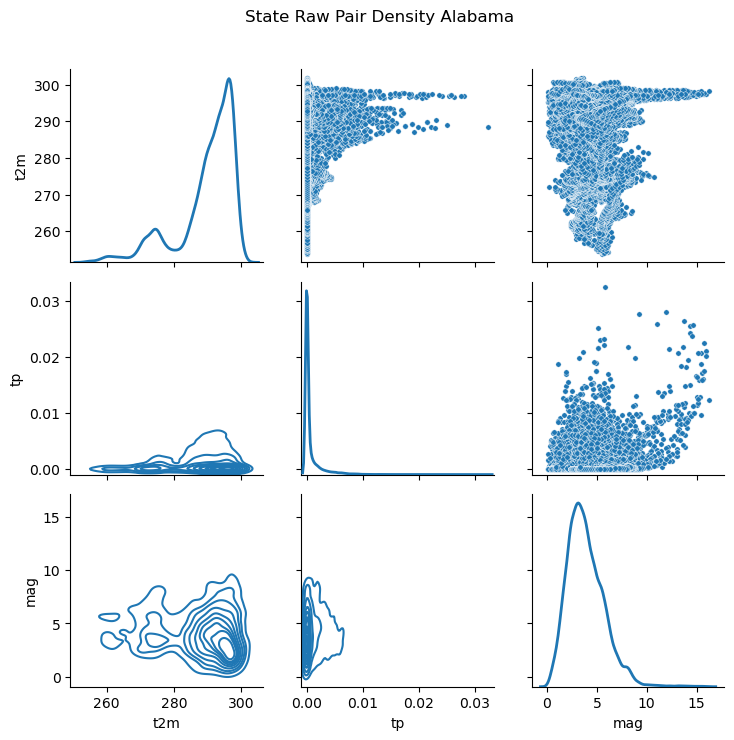

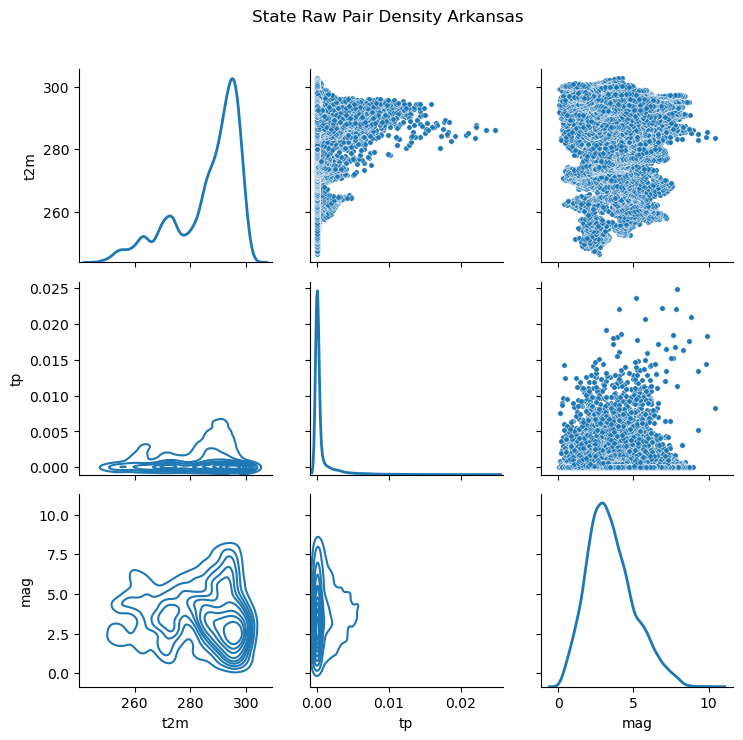

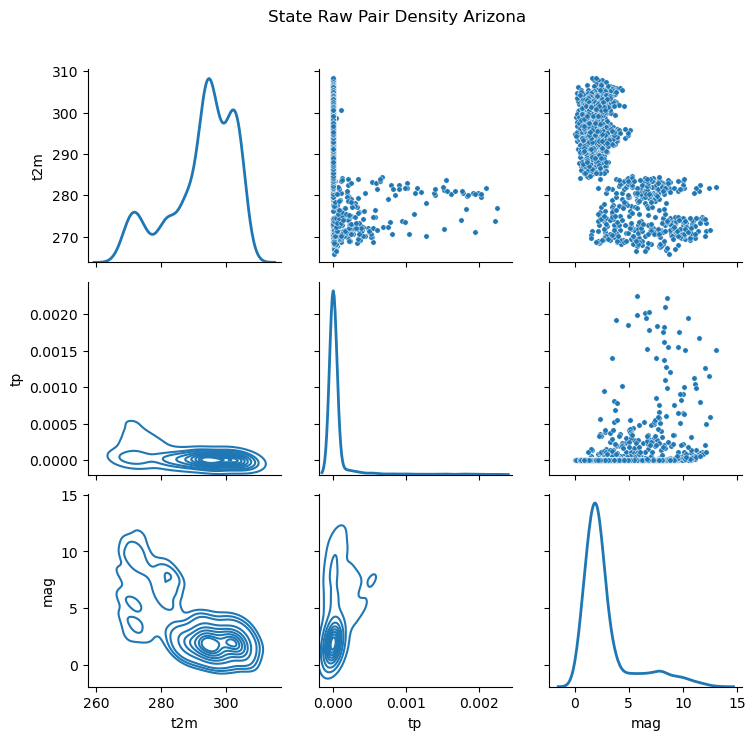

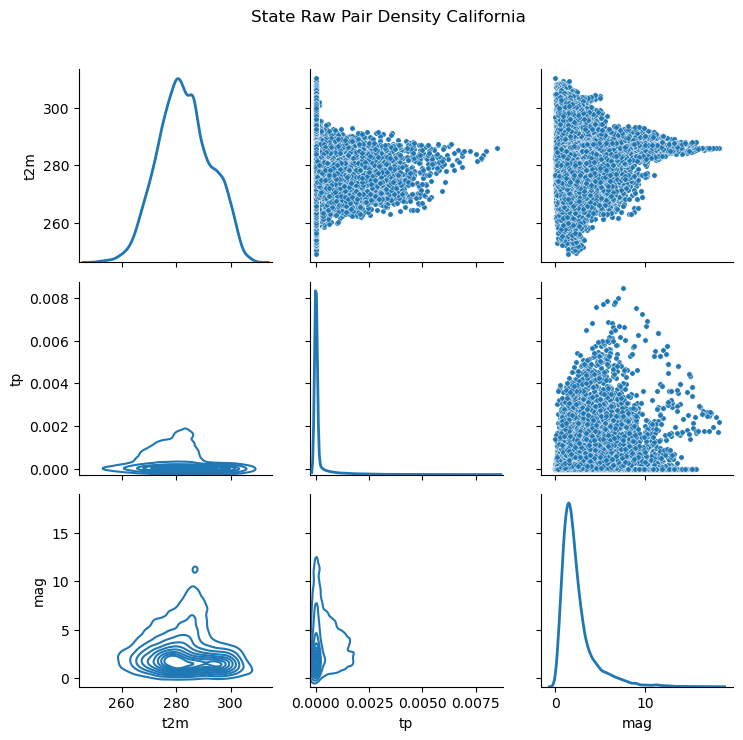

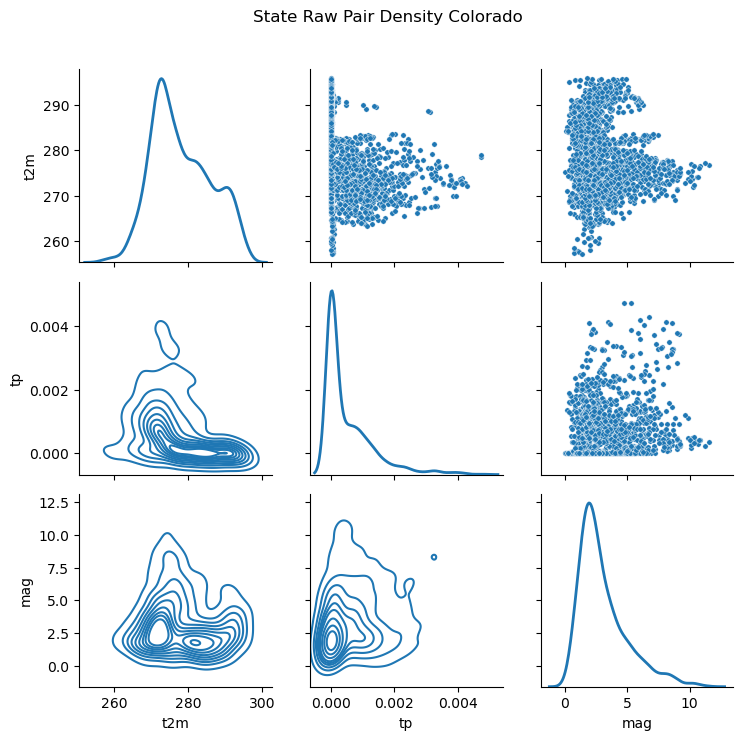

...

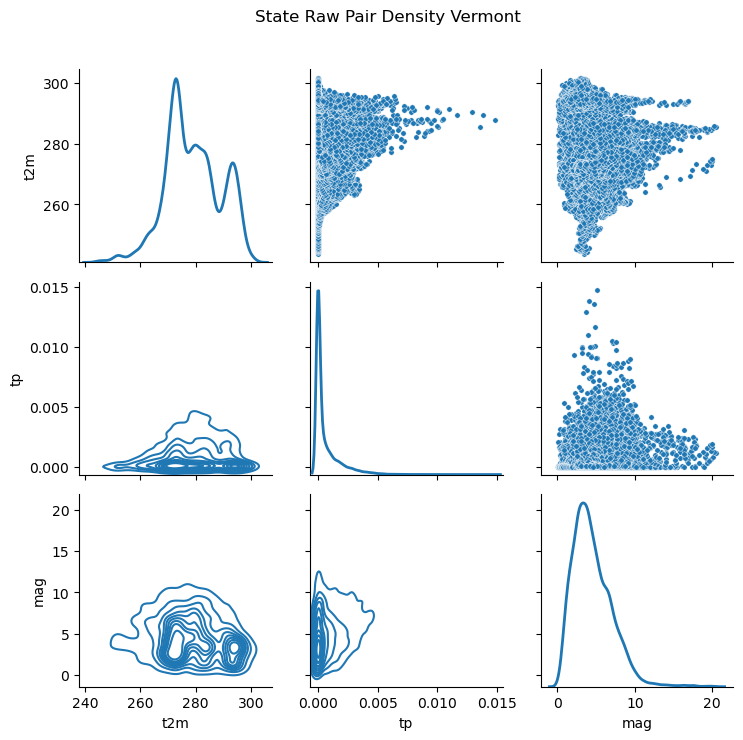

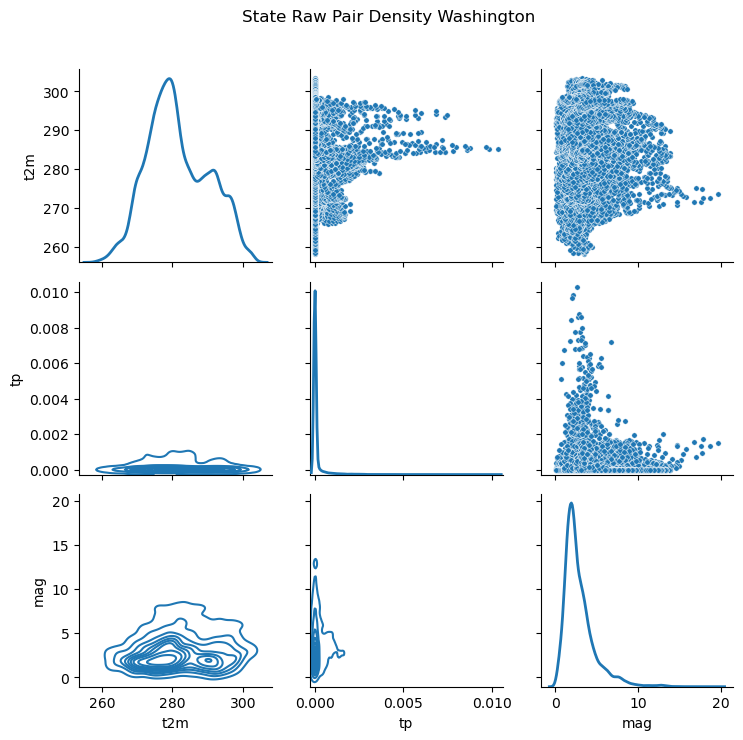

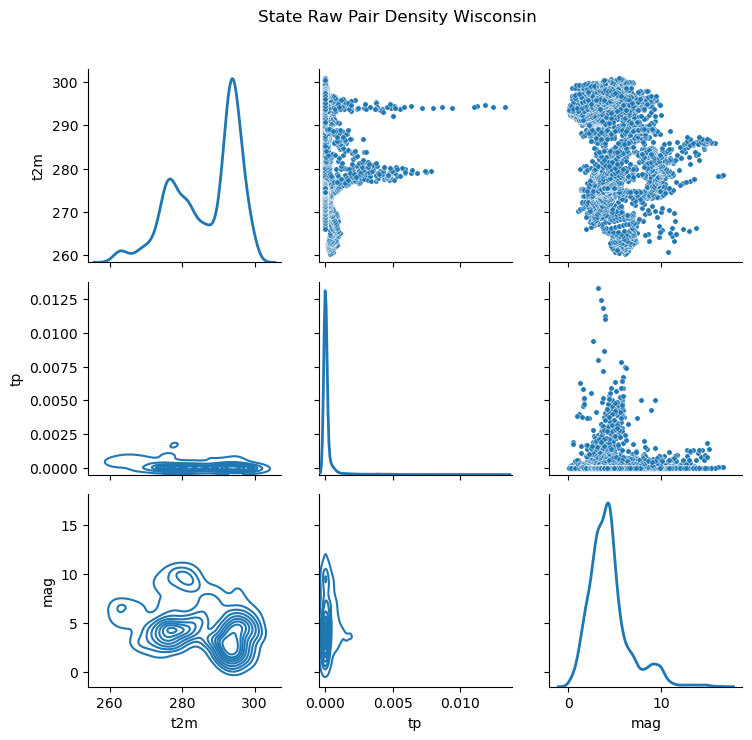

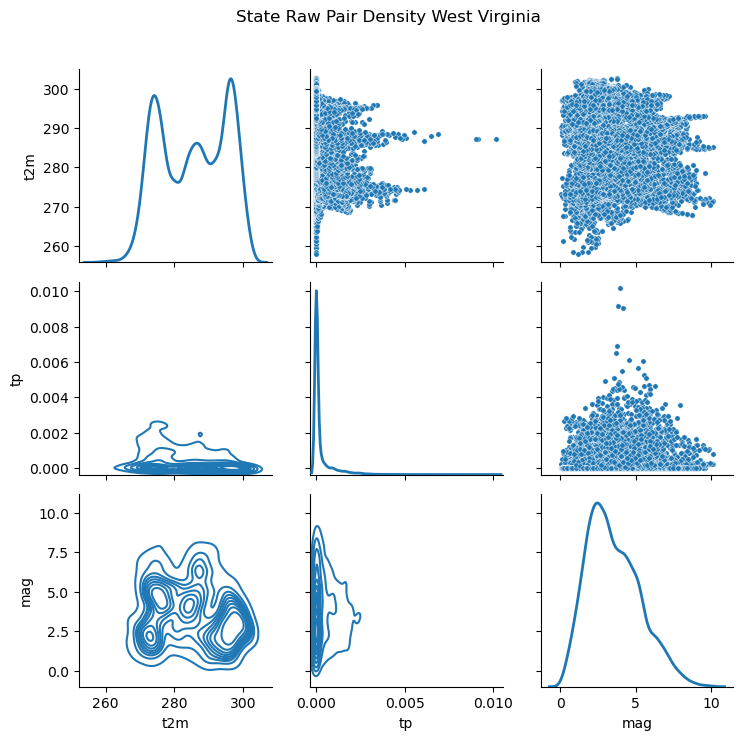

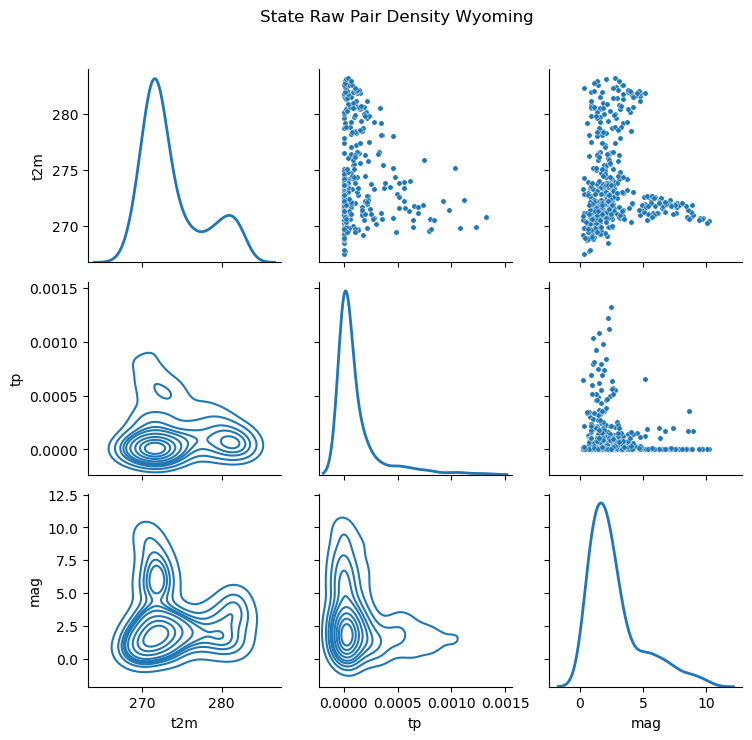

In [43]:
# def custom_upper_plot(x, y, **kwargs):
#     ax = plt.gca()
#     xlim = ax.get_xlim()  # Get initial x-axis limits
#     ylim = ax.get_ylim()  # Get initial y-axis limits
#     sns.scatterplot(x=y, y=x, **kwargs)
#     ax.set_xlim(ylim)  # Set x-axis limits to initial y-axis limits
#     ax.set_ylim(xlim)  # Set y-axis limits to initial x-axis limits
# print(raw_state['California'])


for state in states:
    if raw_state[state].empty:
        continue
    g = sns.PairGrid(raw_state[state], diag_sharey=False)
    g.map_upper(sns.scatterplot, s=15)
    g.map_lower(sns.kdeplot)
    g.map_diag(sns.kdeplot, lw=2)
    g.fig.subplots_adjust(top=0.9)
    g.fig.suptitle("State Raw Pair Density " + state)

    # sc = sns.scatterplot(state_dfs_anom['Oregon'])

    plt.savefig("../visuals/tests/raw_pair_density_" + state + ".png")

/data/keeling/a/rct4/anaconda3/envs/workenv/lib/python3.9/site-packages/seaborn/axisgrid.py:1280: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=figsize)


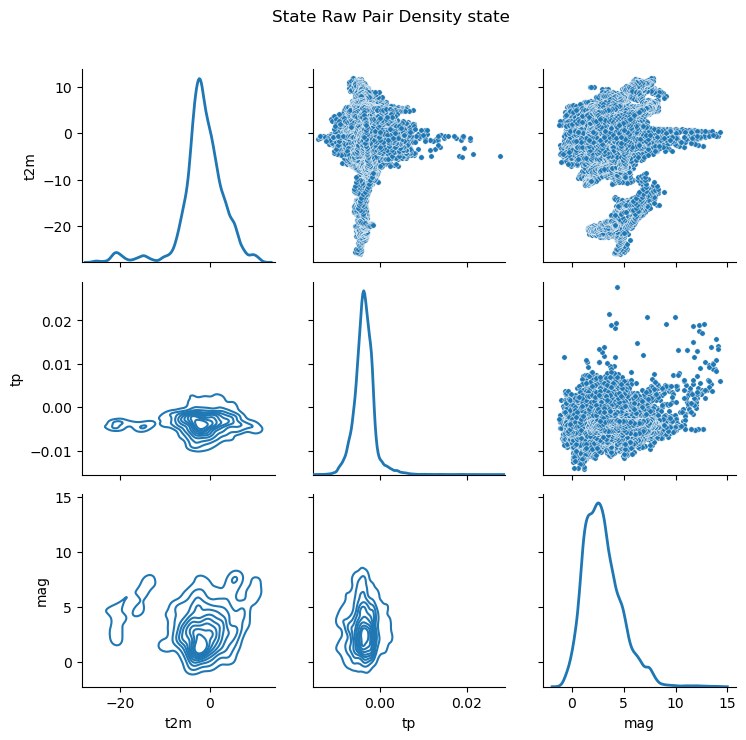

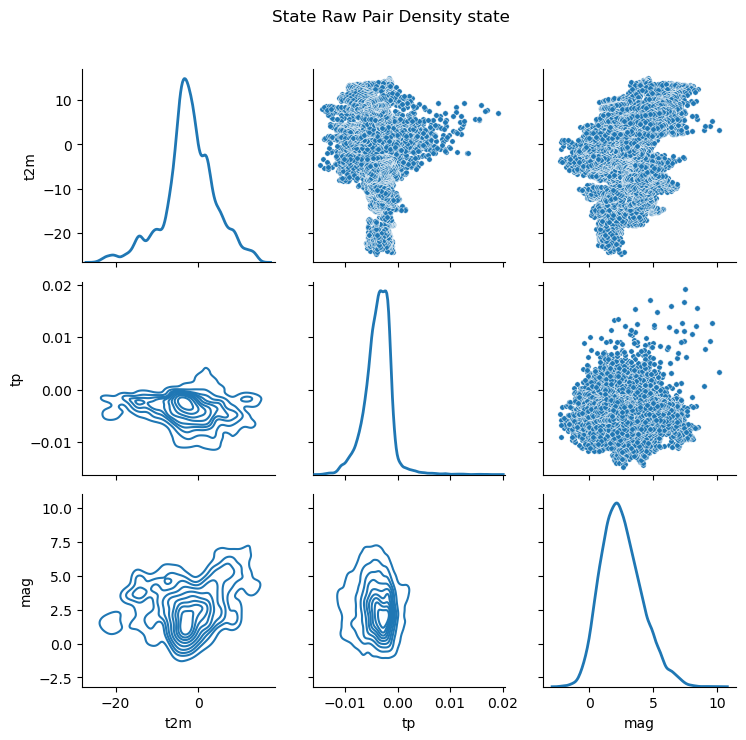

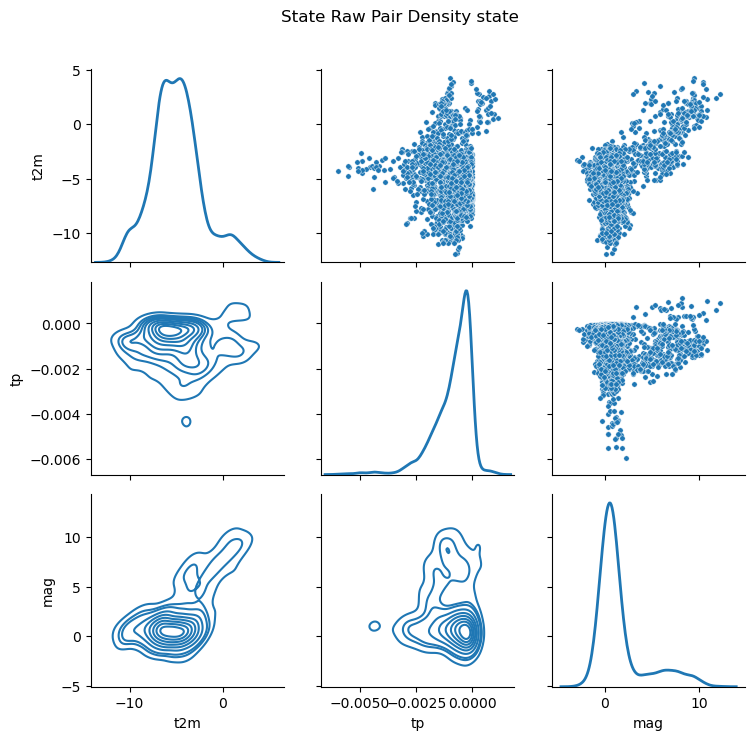

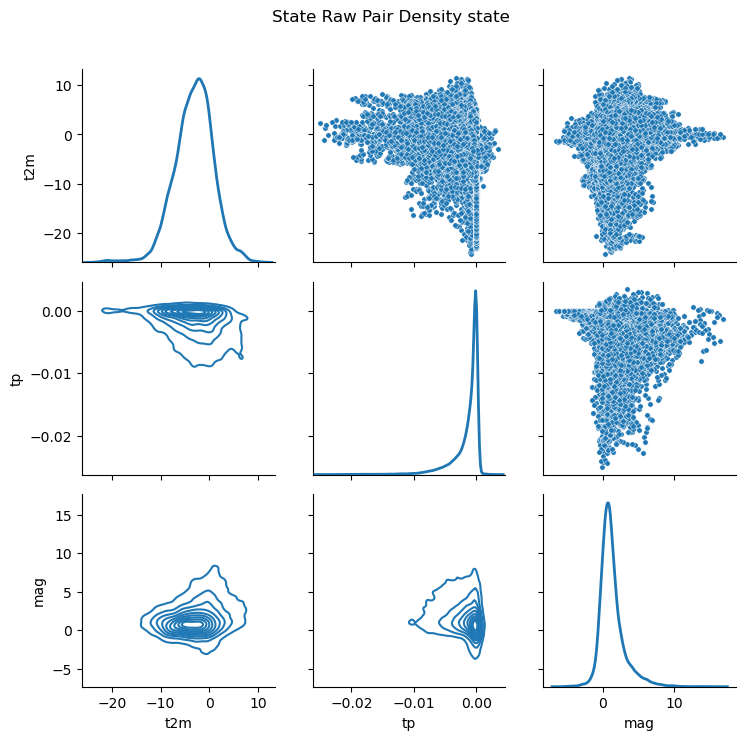

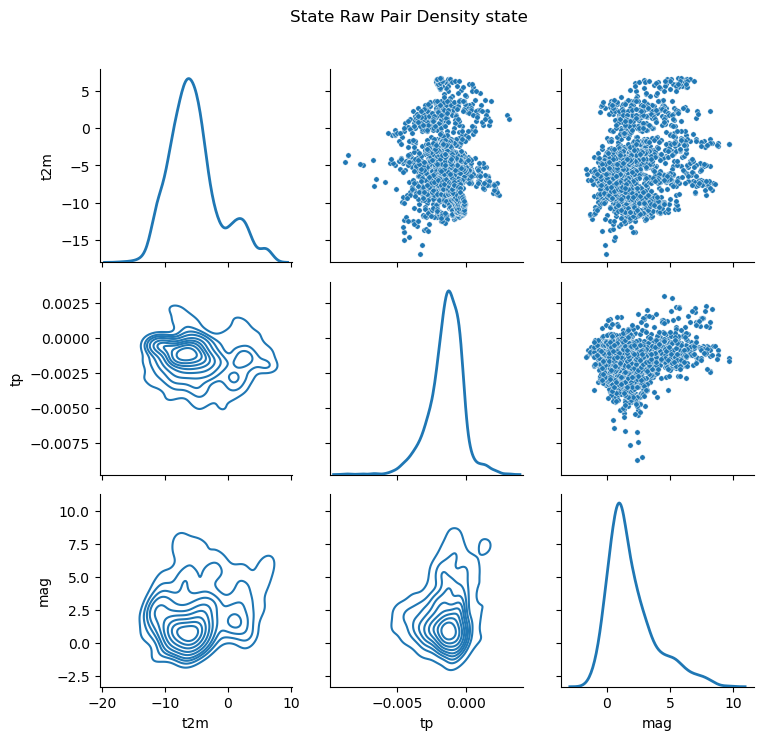

...

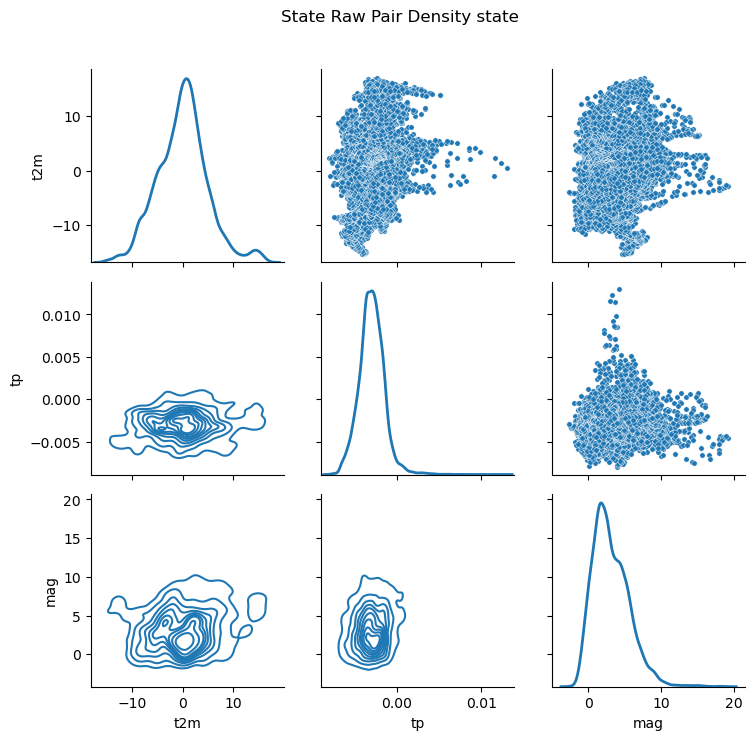

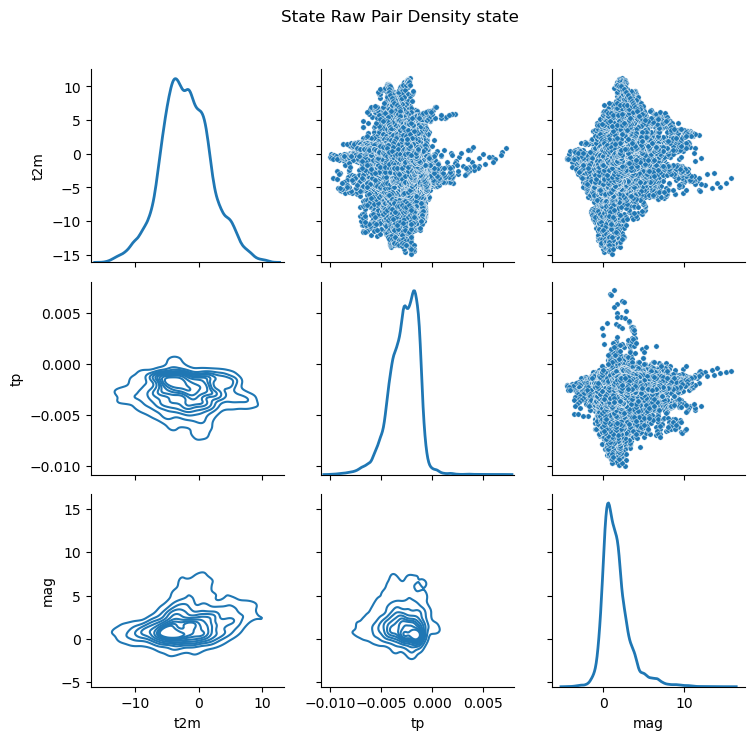

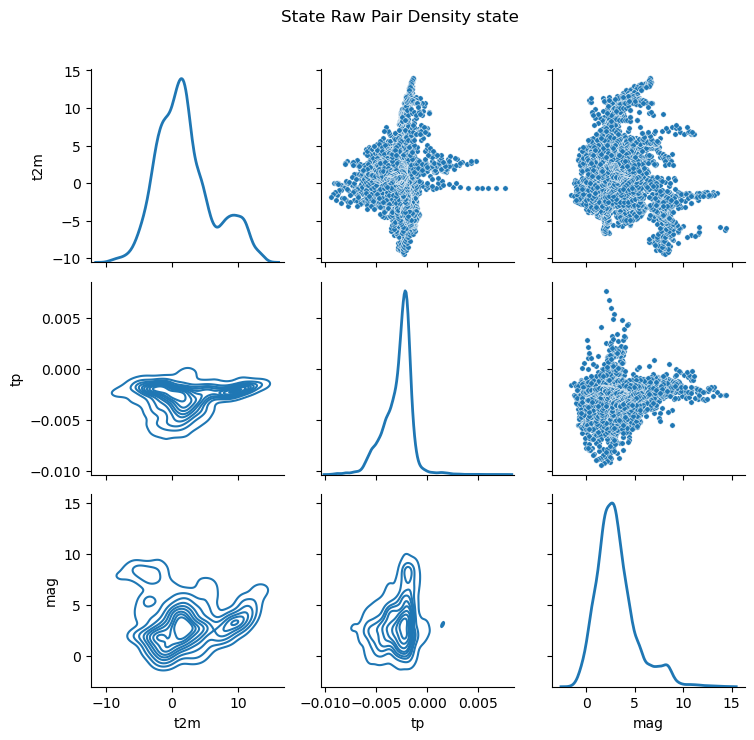

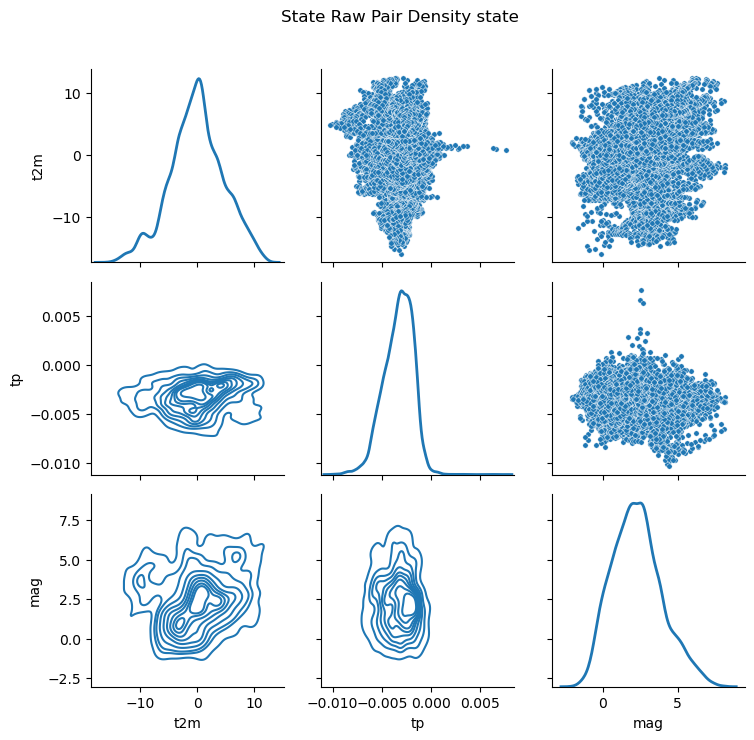

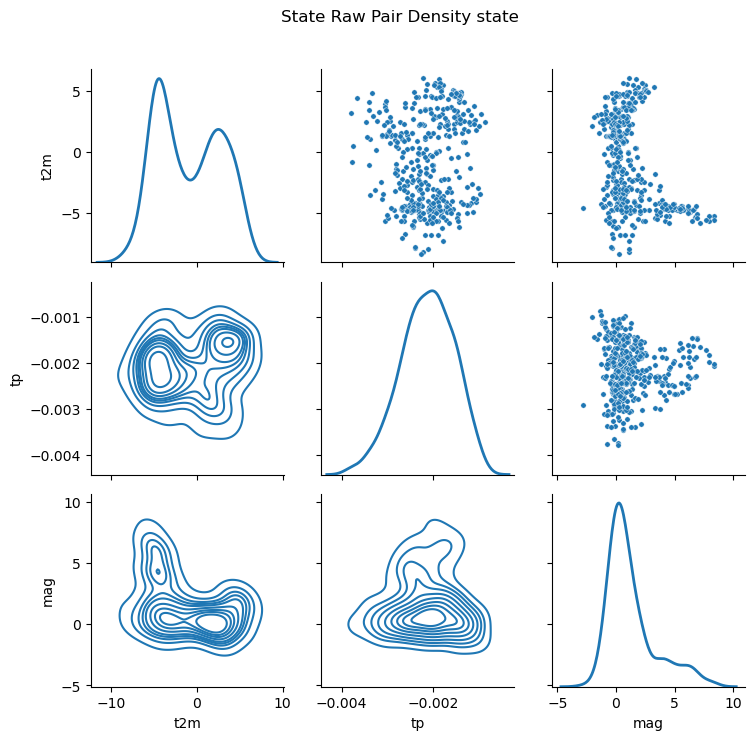

In [40]:
# def custom_upper_plot(x, y, **kwargs):
#     ax = plt.gca()
#     sns.scatterplot(x=y, y=x, **kwargs)
#     ax.set_xlim(ax.get_ylim())  # Swap x and y axes limits

# print(anom_state['Florida'])

for state in states:
    if anom_state[state].empty:
        continue
    g = sns.PairGrid(anom_state[state], diag_sharey=False)
    g.map_upper(sns.scatterplot, s=15)
    g.map_lower(sns.kdeplot)
    g.map_diag(sns.kdeplot, lw=2)
    g.fig.subplots_adjust(top=0.9)
    g.fig.suptitle("State Raw Pair Density " + state)

    # sc = sns.scatterplot(state_dfs_anom['Oregon'])

    plt.savefig("../visuals/kdeplot/anom_pair_density_" + state + ".png")

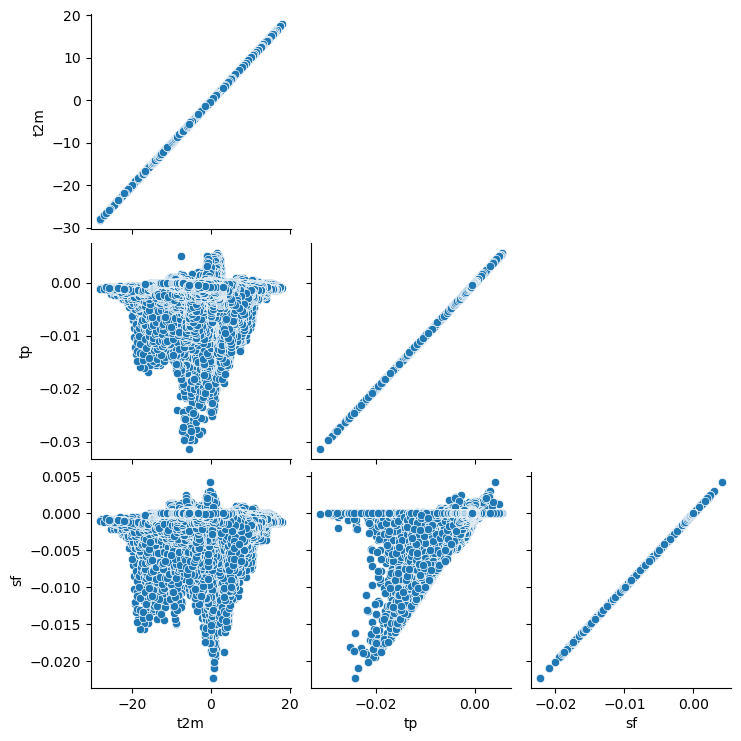

In [28]:
sc = sns.pairplot(state_dfs_anom['Oregon'], corner="lower", diag_kind=None)

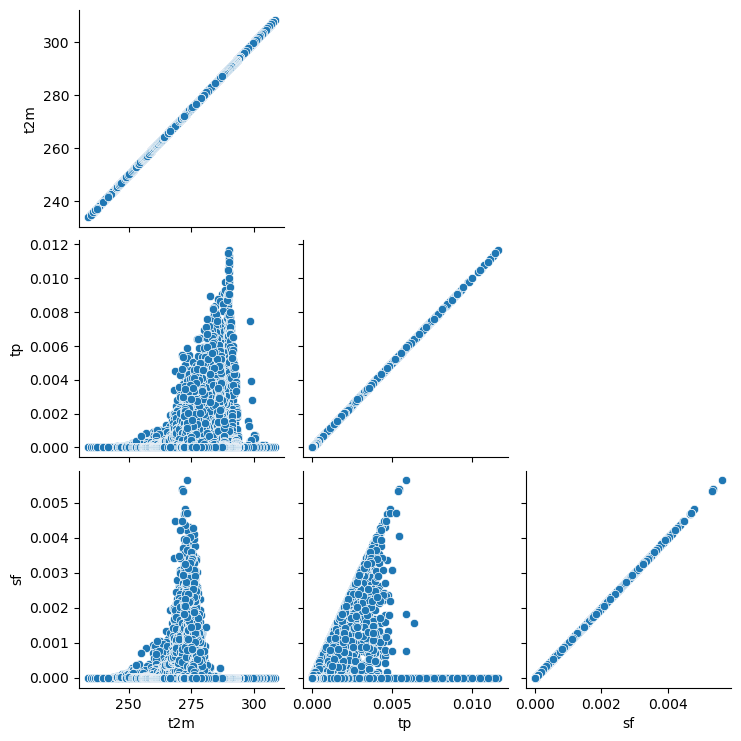

In [32]:
sc = sns.pairplot(state_dfs_raw['Oregon'], corner="lower", diag_kind=None)